<a href="https://colab.research.google.com/github/curibe965/Fundamentos-Inteligencia-Artificial/blob/main/Miniproyecto3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [54]:
import cv2
import os
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten
from tensorflow.keras import Model, Input
from tensorflow.keras.utils import plot_model, to_categorical
from tensorflow.keras.losses import CategoricalCrossentropy

In [55]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [56]:
def load_images_from_folder(folder):
  images = []
  for filename in os.listdir(folder):
    img = cv2.imread(os.path.join(folder, filename))
    if img is not None:
      images.append(img)
  return images

In [57]:
imagenes = load_images_from_folder('/content/drive/MyDrive/Miniproyecto 3/DATASET')

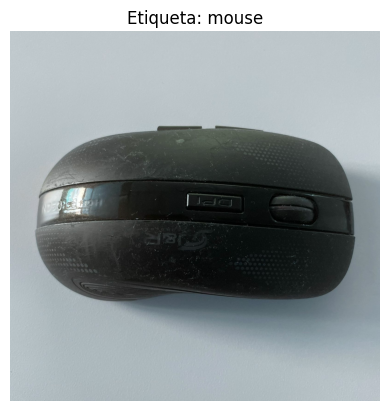

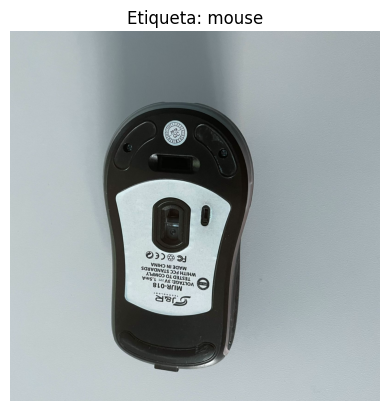

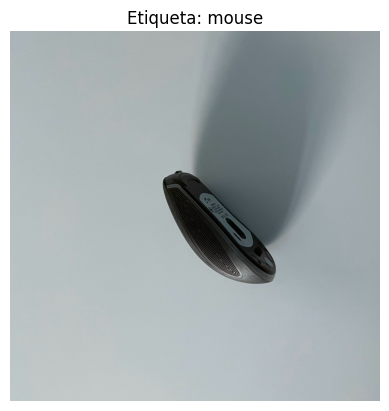

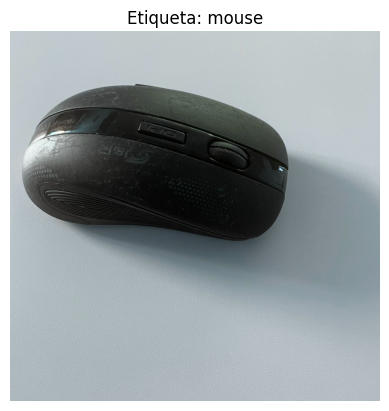

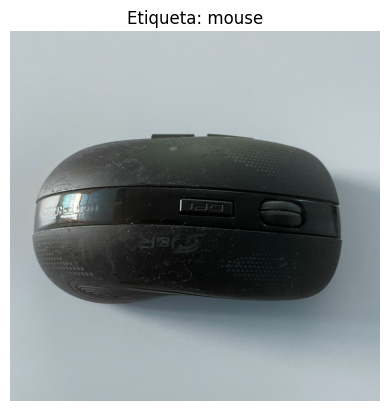

...

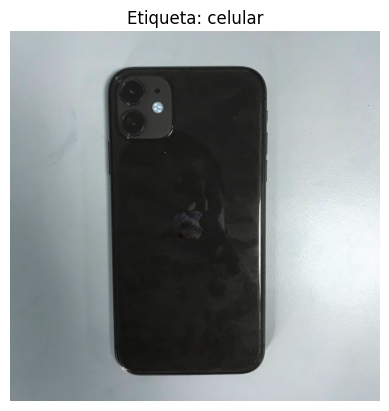

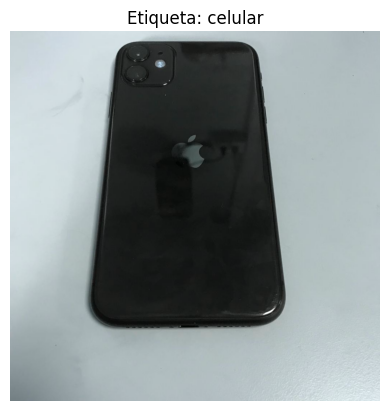

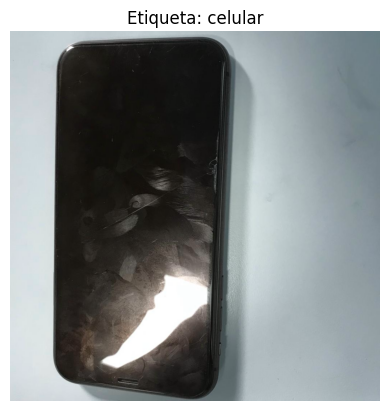

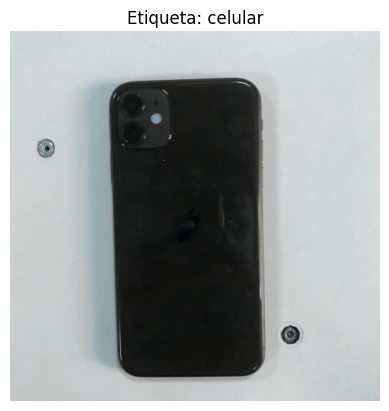

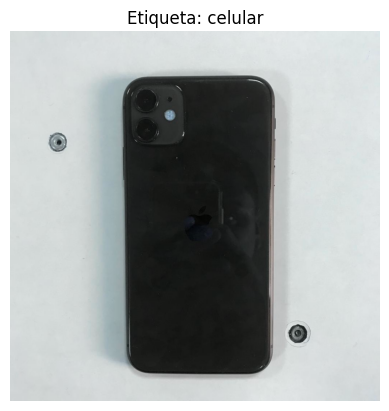

mouse: 50 imágenes
grapadora: 50 imágenes
carro: 50 imágenes
desodorante: 50 imágenes
celular: 50 imágenes


In [64]:
def plot_images(imagenes):
    # Determina el número de filas y columnas para organizar las imágenes en una cuadrícula
    rows = 1
    etiquetas = []  # Usaremos esta lista para asociar etiquetas a cada imagen

    # Itera sobre las imágenes y las muestra en los subgráficos
    for i in range(len(imagenes)):
        # Define las etiquetas
        if 0 <= i < 50:
            etiqueta = 'mouse'
        elif 50 <= i < 100:
            etiqueta = 'grapadora'
        elif 100 <= i < 150:
            etiqueta = 'carro'
        elif 150 <= i < 200:
            etiqueta = 'desodorante'
        elif 200 <= i < 250:
            etiqueta = 'celular'

        # Agrega la etiqueta a la lista
        etiquetas.append(etiqueta)

        # Muestra la imagen solo si cumple con las condiciones
        if etiqueta in ['mouse', 'grapadora', 'carro', 'desodorante', 'celular']:
            plt.imshow(imagenes[i])
            plt.axis('off')  # Desactiva los ejes para una presentación más limpia
            plt.title(f"Etiqueta: {etiqueta}")
            plt.show()

    # Muestra el resumen de etiquetas
    etiquetas_resumen = {}
    for etiqueta in etiquetas:
        if etiqueta in etiquetas_resumen:
            etiquetas_resumen[etiqueta] += 1
        else:
            etiquetas_resumen[etiqueta] = 1

    for etiqueta, cantidad in etiquetas_resumen.items():
        print(f"{etiqueta}: {cantidad} imágenes")

# Uso de la función para plotear las imágenes
plot_images(imagenes)


In [73]:
from collections import Counter

# Suponiendo que tienes una lista de etiquetas llamada 'etiquetas'
etiquetas = ['mouse', 'grapadora', 'carro', 'desodorante', 'celular']

# Cuenta las etiquetas
conteo_etiquetas = Counter(etiquetas)

# Muestra el conteo de etiquetas
print(conteo_etiquetas)


Counter({'mouse': 1, 'grapadora': 1, 'carro': 1, 'desodorante': 1, 'celular': 1})


In [71]:
import random
import matplotlib.pyplot as plt

def mostrar_imagenes_aleatorias_con_etiquetas(imagenes, etiquetas, cantidad_a_mostrar=5):
    # Asegúrate de que cantidad_a_mostrar no sea mayor que la longitud de las listas
    cantidad_a_mostrar = min(cantidad_a_mostrar, len(imagenes), len(etiquetas))

    # Obtén índices aleatorios de imágenes
    indices_aleatorios = random.sample(range(len(imagenes)), cantidad_a_mostrar)

    # Muestra las imágenes y sus etiquetas
    for idx in indices_aleatorios:
        imagen = imagenes[idx]
        etiqueta = etiquetas[idx]

        plt.figure(figsize=(4, 4))
        plt.imshow(imagen)
        plt.axis('off')
        plt.title(f"Etiqueta: {etiqueta}")
        plt.show()

# Uso de la función para mostrar 5 imágenes aleatorias con etiquetas
mostrar_imagenes_aleatorias_con_etiquetas(imagenes, etiquetas, cantidad_a_mostrar=5)


NameError: ignored

In [37]:
import os
import cv2

def calcular_estadisticas_dataset(folder_path):
    # Obtener la lista de archivos de imágenes en la carpeta
    archivos_imagenes = [os.path.join(folder_path, filename) for filename in os.listdir(folder_path) if filename.endswith(('.jpg', '.png', '.jpeg'))]

    # Inicializar listas para almacenar estadísticas
    tamaños = []
    resoluciones = []

    # Calcular estadísticas para cada imagen
    for archivo in archivos_imagenes:
        # Leer la imagen
        img = cv2.imread(archivo)
        if img is not None:
            # Obtener tamaño en bytes
            tamano_bytes = os.path.getsize(archivo)
            tamaños.append(tamano_bytes)

            # Obtener resolución (alto x ancho)
            resolucion = img.shape[:2]  # Formato (alto, ancho)
            resoluciones.append(resolucion)

    # Calcular estadísticas generales
    num_imagenes = len(archivos_imagenes)
    tamano_promedio = np.mean(tamaños)
    tamano_maximo = max(tamaños)
    tamano_minimo = min(tamaños)
    resolucion_maxima = max(resoluciones)
    resolucion_minima = min(resoluciones)

    # Imprimir estadísticas
    print(f"Número total de imágenes: {num_imagenes}")
    print(f"Tamaño promedio de imágenes: {tamano_promedio} bytes")
    print(f"Tamaño máximo de imágenes: {tamano_maximo} bytes")
    print(f"Tamaño mínimo de imágenes: {tamano_minimo} bytes")
    print(f"Resolución máxima: {resolucion_maxima}")
    print(f"Resolución mínima: {resolucion_minima}")

# Ruta de la carpeta que contiene las imágenes en Google Drive
carpeta_imagenes = '/content/drive/MyDrive/Miniproyecto 3/DATASET'

# Llama a la función para calcular estadísticas
calcular_estadisticas_dataset(carpeta_imagenes)


Número total de imágenes: 250
Tamaño promedio de imágenes: 169137.284 bytes
Tamaño máximo de imágenes: 441346 bytes
Tamaño mínimo de imágenes: 26078 bytes
Resolución máxima: (1600, 1600)
Resolución mínima: (1024, 1024)


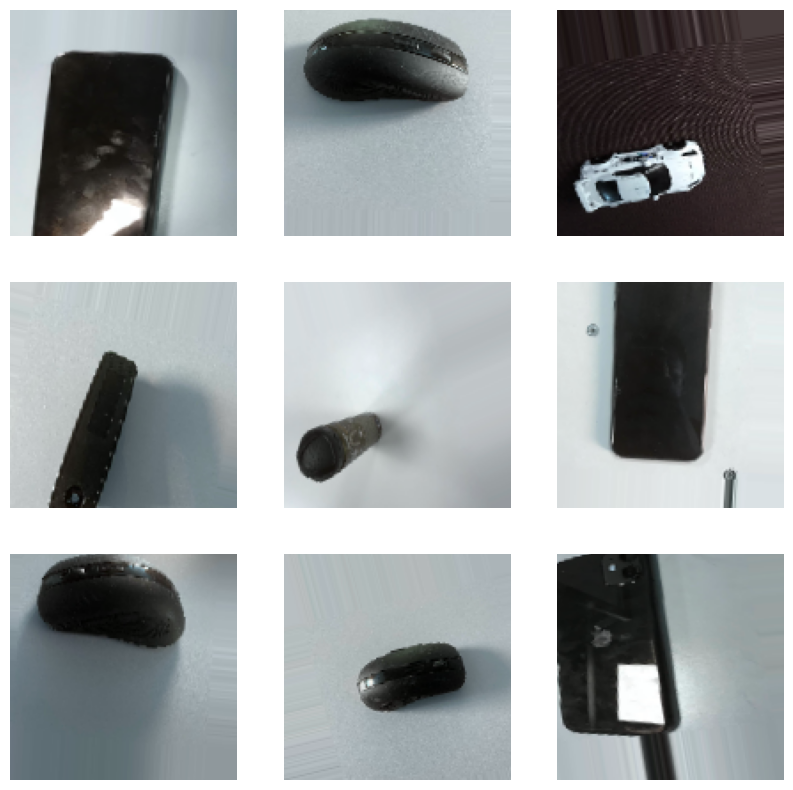

In [32]:
from keras.preprocessing.image import ImageDataGenerator

# Directorio que contiene tus imágenes redimensionadas en Google Drive
directorio_imagenes = '/content/drive/MyDrive/Miniproyecto 3/DATASET'

# Crear un generador de aumentación de datos para imágenes en tres canales RGB
datagen = ImageDataGenerator(
    rotation_range=20,        # Rango de rotación
    width_shift_range=0.2,    # Desplazamiento horizontal
    height_shift_range=0.2,   # Desplazamiento vertical
    shear_range=0.2,          # Cizallamiento
    zoom_range=0.2,           # Zoom
    horizontal_flip=True,     # Volteo horizontal
    fill_mode='nearest'       # Modo de relleno
)

# Lista para almacenar las imágenes aumentadas
imagenes_aumentadas = []

# Cargar y redimensionar las imágenes desde Google Drive
for filename in os.listdir(directorio_imagenes):
    if filename.endswith(('.jpg', '.png', '.jpeg')):
        ruta_imagen = os.path.join(directorio_imagenes, filename)
        imagen = cv2.imread(ruta_imagen)
        imagen = cv2.resize(imagen, (128, 128))
        imagenes_aumentadas.append(imagen)

# Convertir la lista de imágenes a un array numpy
imagenes_aumentadas = np.array(imagenes_aumentadas)

# Aplicar aumentación de datos
datagen.fit(imagenes_aumentadas)

# Generar imágenes aumentadas
batch_size = 32
generador = datagen.flow(imagenes_aumentadas, batch_size=batch_size)

# Ejemplo: Mostrar algunas imágenes aumentadas
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))
for i in range(9):
    plt.subplot(3, 3, i+1)
    imagenes = generador.next()
    imagen = imagenes[0].astype(np.uint8)  # Ajustar el rango a [0, 255]
    plt.imshow(imagen)
    plt.axis('off')
plt.show()


In [42]:
print(len(imagenes_redimensionadas))
print(len(etiquetas))

250
5


In [34]:
from sklearn.model_selection import train_test_split

# Divide el conjunto de datos en entrenamiento y validación
X_train, X_test, y_train, y_test = train_test_split(imagenes_aumentadas, etiquetas, test_size=proporcion_validacion, random_state=42)


# Muestra la cantidad de datos en cada conjunto
print(f"Cantidad de datos en conjunto de entrenamiento: {len(X_train)}")
print(f"Cantidad de datos en conjunto de prueba: {len(X_test)}")


ValueError: ignored